# Data analysis of microstates data
Looking into
* microstates distribution per trials
* means duration of microstates per trials
* ocurrences per seconds of microstates in the data per trials
* time coverage ratio of microstates per trials
* transition probabilities between microstates



## Load packages


In [1]:
import os
import mne
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme(style="darkgrid")

# change directory go into Notebooks folder
if os.path.basename(os.getcwd()) != 'Notebooks':
    if os.path.basename(os.getcwd()) == 'lib':
        os.chdir(os.path.join(os.getcwd(), '..', 'Notebooks'))
    else:
        os.chdir(os.path.join(os.getcwd(), 'Notebooks'))
else:
    # if already in Notebooks folder, do nothing
    pass

from lib import my_functions as mf

In [2]:
mf.test_lib()

# Check if the data folder and file exist
print('Current working directory:', os.getcwd())

Library is working correctly.
Current working directory: c:\Users\josan\Documents\EPFL\These\Notebooks


In [62]:
id = 0

data_path = '../Output/'
folder_path = 'ica_rest_open/'
output_path = '../Output/' + folder_path
if not os.path.exists(output_path):
    os.makedirs(output_path)

id_name = f'{id:03d}'  # Format id as three digits
# id_name ='_all'
file_name = f'k{id_name}.npy'

In [13]:
n_clusters = 4  # Number of clusters

rest_ch_ls = ['Fp1', 'Fz', 'F3', 'F7', 'FT9', 'FC5', 'FC1', 'C3', 'T7', 'CP5', 'CP1', 'Pz', 'P3',
                'P7', 'O1', 'Oz', 'O2', 'P4', 'P8', 'CP6', 'CP2', 'Cz', 'C4', 'T8', 'FT10', 'FC6',
                'FC2', 'F4', 'F8', 'Fp2', 'AF7', 'AF3', 'AFz', 'F1', 'F5', 'FT7', 'FC3', 'C1', 'C5',
                'TP7', 'CP3', 'P1', 'P5', 'PO7', 'PO3', 'POz', 'PO4', 'PO8', 'P6', 'P2', 'CPz',
                'CP4', 'TP8', 'C6', 'C2', 'FC4', 'FT8', 'F6', 'AF8', 'AF4', 'F2']
sampling_rate = 250 # Hz

colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']  # Microstate colors

# -------------------------------- Load data --------------------------------


print(f'Extracting microstates for subject {id_name}...')

data = mf.get_file_path(data_path, folder_path, file_name)

Extracting microstates for subject 000...


In [7]:
data

array([0.5852962 , 0.23632465, 0.17847209, 0.17932598, 0.15596281,
       0.14449583, 0.12789854, 0.12563354, 0.12020082], dtype=float32)

## For 1 subject
### Microstates distribution per trials

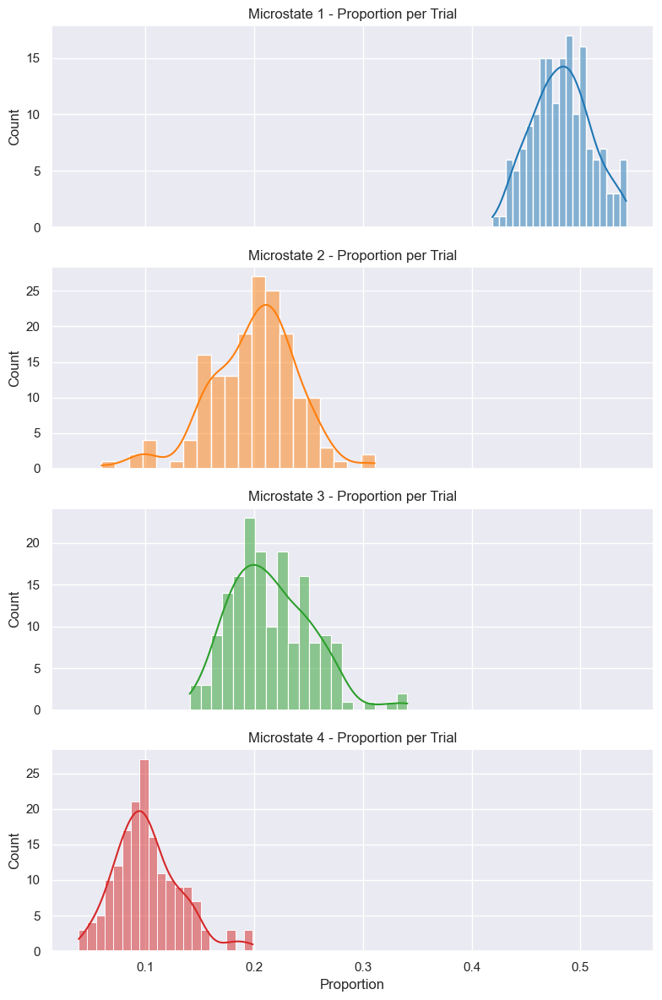

In [5]:
# Count occurrences of each microstate per trial
counts = []
for trial in data:
    unique, counts_trial = np.unique(trial, return_counts=True)
    count_dict = {f'ms{state}': 0 for state in range(4)}
    for u, c in zip(unique, counts_trial):
        count_dict[f'ms{u}'] = c
    counts.append(count_dict)

df_counts = pd.DataFrame(counts)

# Optional: convert to percentage of total time points
df_counts_pct = df_counts.div(df_counts.sum(axis=1), axis=0)

# Plotting distributions across trials
fig, axs = plt.subplots(4, 1, figsize=(8, 12), sharex=True)

for i in range(4):
    ax = axs[i]
    sns.histplot(df_counts_pct[f'ms{i}'], bins=20, kde=True, ax=ax, color=colors[i], stat='count')
    ax.set_title(f"Microstate {i+1} - Proportion per Trial")
    ax.set_ylabel("Count")
    if i == 3:
        ax.set_xlabel("Proportion")

plt.tight_layout()
plt.show()


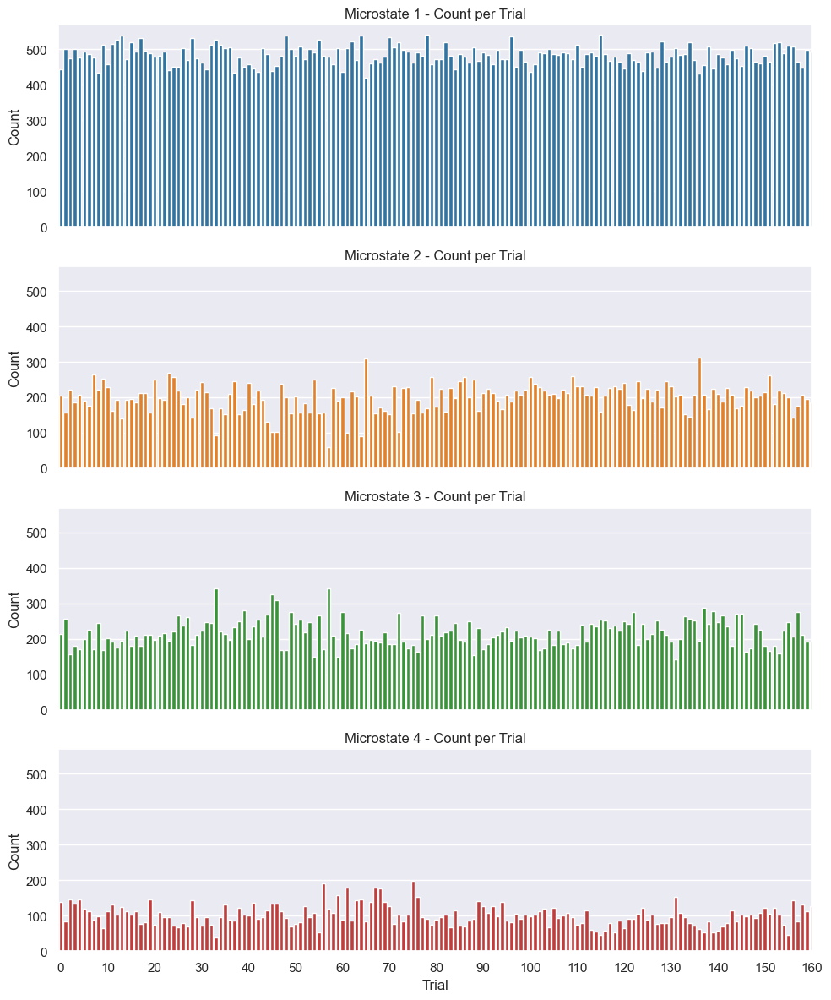

In [6]:
# Compute count of each microstate per trial
counts = []
for trial in data:
    count_dict = {f'ms{state}': 0 for state in range(4)}
    unique, counts_trial = np.unique(trial, return_counts=True)
    for u, c in zip(unique, counts_trial):
        count_dict[f'ms{u}'] = c
    counts.append(count_dict)

df_counts = pd.DataFrame(counts)  # shape (n_trials, 4)

# Plotting
fig, axs = plt.subplots(4, 1, figsize=(10, 12), sharex=True, sharey=True)

for i in range(4):
    ax = axs[i]
    sns.barplot(
        x=np.arange(len(df_counts)),
        y=df_counts[f'ms{i}'],
        ax=ax,
        color=colors[i]
    )
    ax.set_title(f"Microstate {i+1} - Count per Trial")
    ax.set_ylabel("Count")
    if i == 3:
        ax.set_xlabel("Trial")
    # set x ticks for every 20 trials
    ax.set_xticks(np.arange(0, len(df_counts), 10))
    ax.set_xticklabels(np.arange(0, len(df_counts), 10))


plt.tight_layout()
plt.show()


C:\Users\josan\AppData\Local\Temp\ipykernel_1252\2379433049.py:7: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([f'Microstate {i+1}' for i in range(4)])


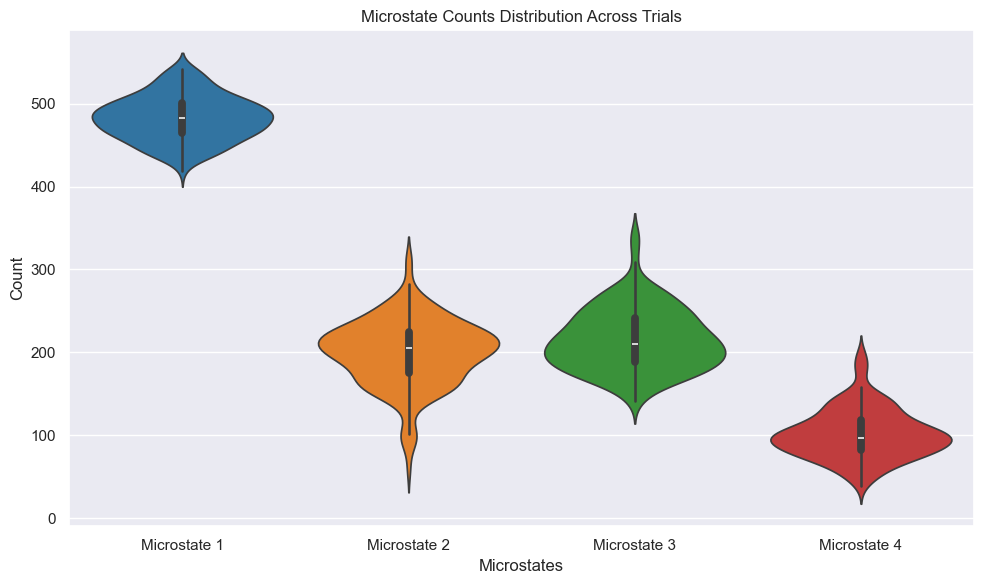

In [7]:
# violin plot
fig, ax = plt.subplots(figsize=(10, 6))
sns.violinplot(data=df_counts, ax=ax, palette=colors)
ax.set_title("Microstate Counts Distribution Across Trials")
ax.set_ylabel("Count")
ax.set_xlabel("Microstates")
ax.set_xticklabels([f'Microstate {i+1}' for i in range(4)])
plt.tight_layout()
plt.show()


### Mean duration of microstates per trials


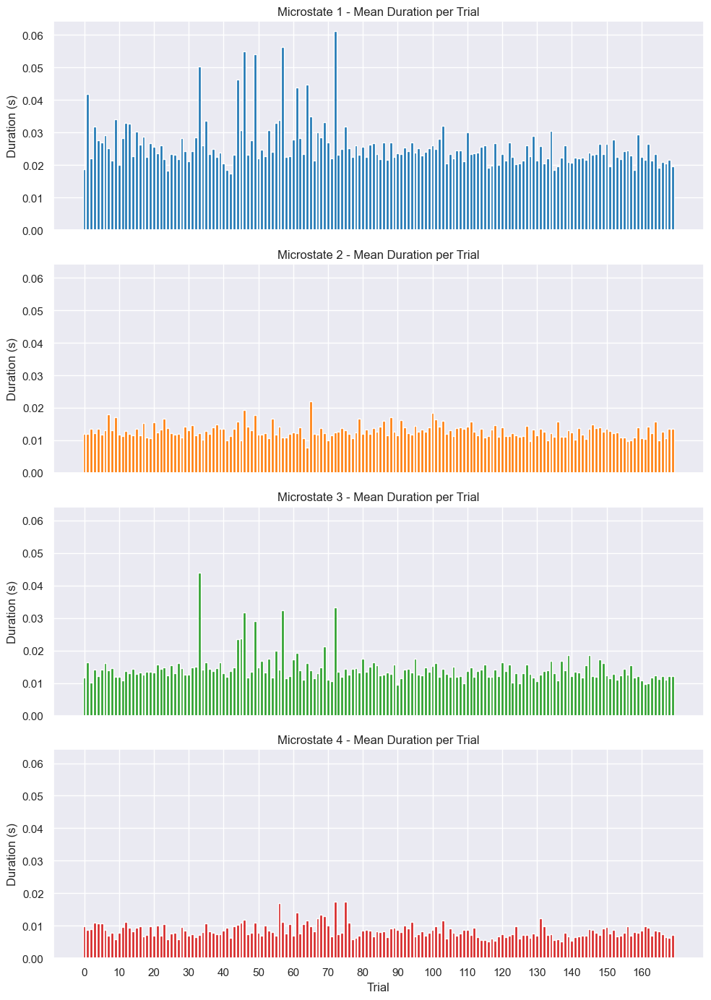

In [8]:
# Assume 'data' is your (n_trials, 1000) array
sampling_rate = 250  # Hz
time_per_sample = 1 / sampling_rate

all_means = []
all_stds = []

for trial in data:
    durations = {state: [] for state in range(4)}
    current_state = trial[0]
    start_idx = 0

    for i in range(1, len(trial)):
        if trial[i] != current_state:
            duration = (i - start_idx) * time_per_sample
            durations[current_state].append(duration)
            current_state = trial[i]
            start_idx = i
    duration = (len(trial) - start_idx) * time_per_sample
    durations[current_state].append(duration)

    mean_durations = {f'ms{state}': np.mean(durations[state]) if durations[state] else 0 for state in range(4)}
    std_durations = {f'ms{state}_std': np.std(durations[state]) if durations[state] else 0 for state in range(4)}
    
    all_means.append(mean_durations)
    all_stds.append(std_durations)

# Create DataFrames
df_means = pd.DataFrame(all_means)
df_stds = pd.DataFrame(all_stds)

# Plotting
fig, axs = plt.subplots(4, 1, figsize=(10, 14), sharex=True, sharey=True)

for i in range(4):
    ax = axs[i]
    mean_vals = df_means[f'ms{i}']
    std_vals = df_stds[f'ms{i}_std']

    ax.bar(np.arange(len(mean_vals)), mean_vals, capsize=3, color=colors[i])
    ax.set_title(f"Microstate {i+1} - Mean Duration per Trial")
    ax.set_ylabel("Duration (s)")
    if i == 3:
        ax.set_xlabel("Trial")
    ax.set_xticks(np.arange(0, len(df_means), 10))
    ax.set_xticklabels(np.arange(0, len(df_means), 10))

plt.tight_layout()
plt.show()


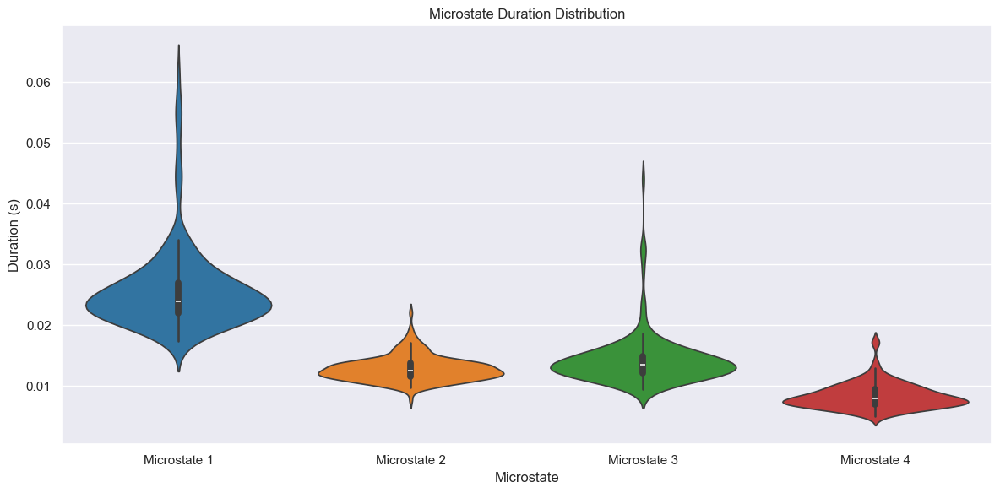

In [9]:
# plot microstate distribution as a violin plot
plt.figure(figsize=(12, 6))
sns.violinplot(data=df_means, palette=colors)
plt.title("Microstate Duration Distribution")
plt.xlabel("Microstate")
plt.ylabel("Duration (s)")
plt.xticks(ticks=np.arange(4), labels=[f'Microstate {i+1}' for i in range(4)])

plt.tight_layout()



### Mean occurrences per seconds of microstates in the data per trials

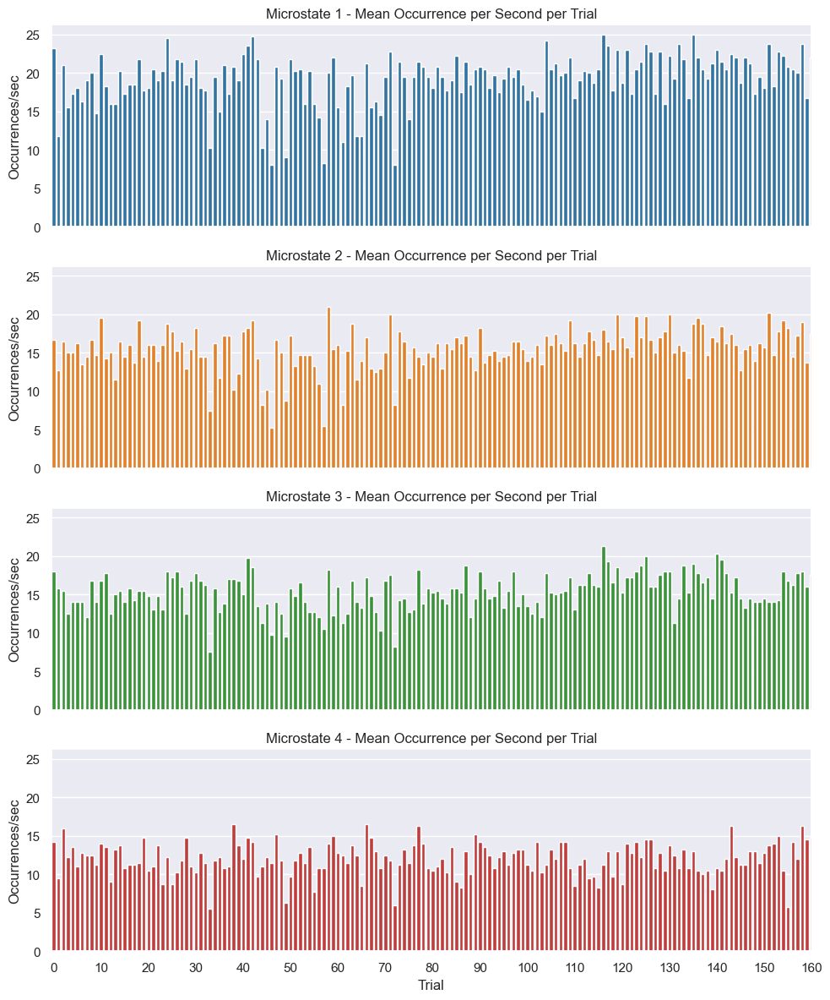

In [10]:

sampling_rate = 250  # 250 Hz → 1s = 250 samples
window_size = sampling_rate  # 1 second
n_trials, n_timepoints = data.shape
n_windows = n_timepoints // window_size

# List to hold mean occurrences per second for each trial
mean_occurrences_per_trial = []

for trial in data:
    occ_counts = {state: [] for state in range(4)}
    for w in range(n_windows):
        start = w * window_size
        end = start + window_size
        segment = trial[start:end]
        prev = segment[0]
        occurrences = {state: 0 for state in range(4)}
        # Count transitions into each state
        for i in range(1, len(segment)):
            if segment[i] != prev:
                occurrences[segment[i]] += 1
                prev = segment[i]
        for state in range(4):
            occ_counts[state].append(occurrences[state])
    
    # Compute mean occurrence per second in this trial
    mean_per_state = {f'ms{state}': np.mean(occ_counts[state]) for state in range(4)}
    mean_occurrences_per_trial.append(mean_per_state)

# Convert to DataFrame
df_occ = pd.DataFrame(mean_occurrences_per_trial)  # shape: (n_trials, 4)

# Plotting
fig, axs = plt.subplots(4, 1, figsize=(10, 12), sharex=True, sharey=True)

for i in range(4):
    ax = axs[i]
    sns.barplot(x=np.arange(len(df_occ)), y=df_occ[f'ms{i}'], ax=ax, color=colors[i])
    ax.set_title(f"Microstate {i+1} - Mean Occurrence per Second per Trial")
    ax.set_ylabel("Occurrences/sec")
    if i == 3:
        ax.set_xlabel("Trial")
    ax.set_xticks(np.arange(0, len(df_occ), 10))
    ax.set_xticklabels(np.arange(0, len(df_occ), 10))

plt.tight_layout()
plt.show()


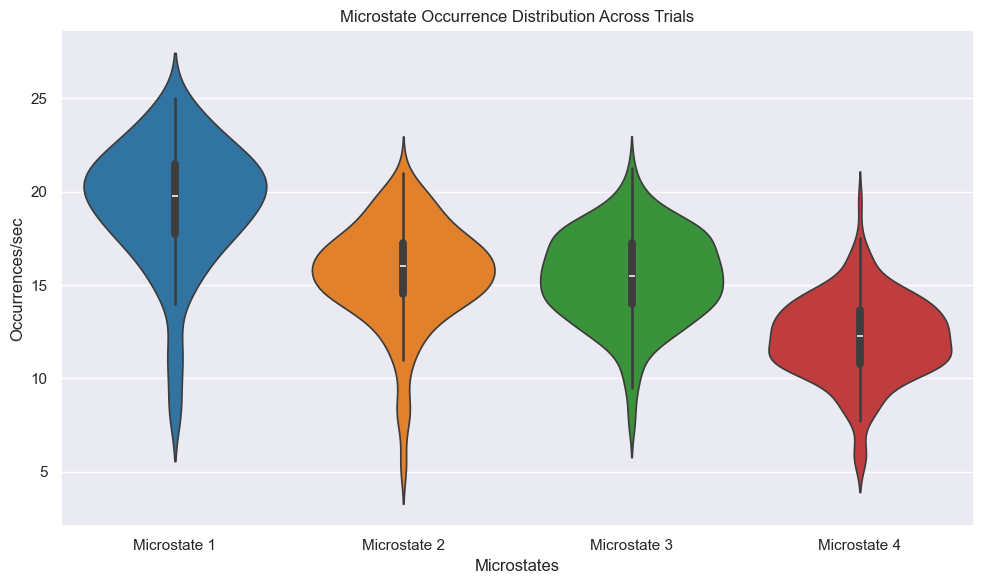

In [11]:
# violin plot
plt.figure(figsize=(10, 6))
sns.violinplot(data=df_occ, palette=colors)
plt.title("Microstate Occurrence Distribution Across Trials")
plt.ylabel("Occurrences/sec")
plt.xlabel("Microstates")
plt.xticks(ticks=np.arange(4), labels=[f'Microstate {i+1}' for i in range(4)])
plt.tight_layout()
plt.show()

### Time coverage ratio of microstates per trials

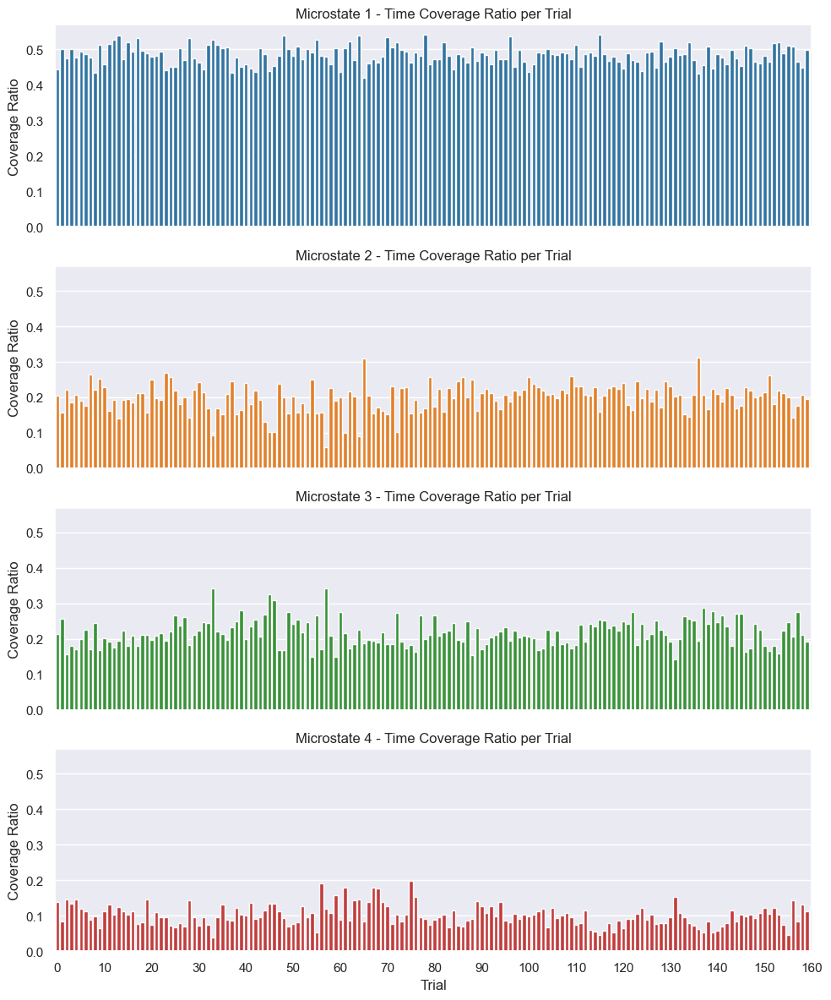

In [12]:
# Calculate coverage ratio per microstate per trial
coverage = []
n_points = data.shape[1]  # 1000 samples per trial

for trial in data:
    coverage_dict = {}
    for state in range(4):
        coverage_dict[f'ms{state}'] = np.sum(trial == state) / n_points
    coverage.append(coverage_dict)

df_coverage = pd.DataFrame(coverage)

# Plotting
fig, axs = plt.subplots(4, 1, figsize=(10, 12), sharex=True, sharey=True)

for i in range(4):
    ax = axs[i]
    sns.barplot(x=np.arange(len(df_coverage)), y=df_coverage[f'ms{i}'], ax=ax, color=colors[i])
    ax.set_title(f"Microstate {i+1} - Time Coverage Ratio per Trial")
    ax.set_ylabel("Coverage Ratio")
    if i == 3:
        ax.set_xlabel("Trial")
    ax.set_xticks(np.arange(0, len(df_coverage), 10))
    ax.set_xticklabels(np.arange(0, len(df_coverage), 10))

plt.tight_layout()
plt.show()


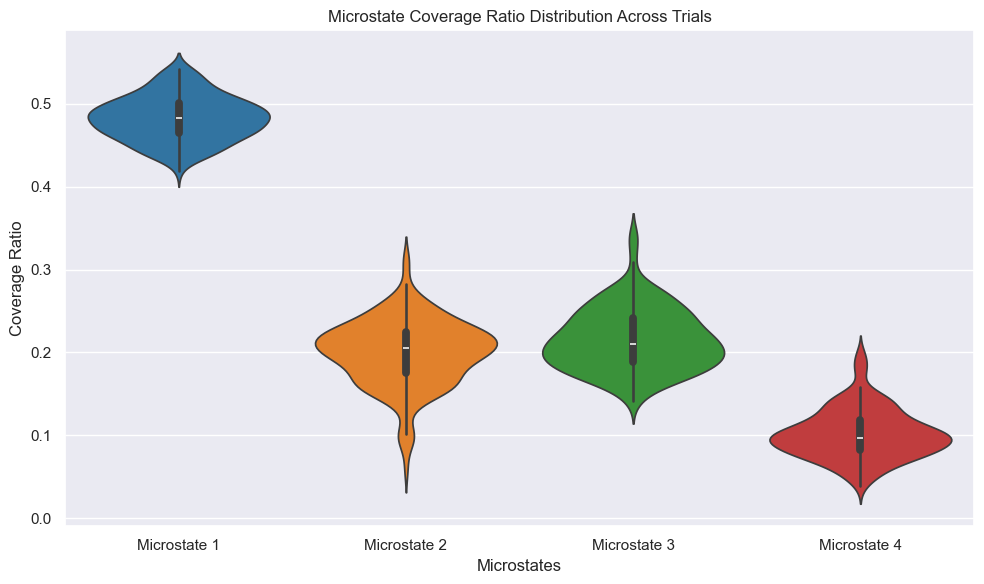

In [13]:
#violin plot
plt.figure(figsize=(10, 6))
sns.violinplot(data=df_coverage, palette=colors)
plt.title("Microstate Coverage Ratio Distribution Across Trials")
plt.xlabel("Microstates")
plt.ylabel("Coverage Ratio")
plt.xticks(ticks=np.arange(4), labels=[f'Microstate {i+1}' for i in range(4)])
plt.tight_layout()


## All subjects

In [14]:
# load all data
n_subjects = 50
all_data = []
for i in range(0, n_subjects):
    id_name = f'{i:03d}'  # Format id as three digits
    file_name = f'm{id_name}.npy'
    data = mf.get_file_path(data_path, folder_path, file_name)
    all_data.append(data)

### Microstates distribution per trials

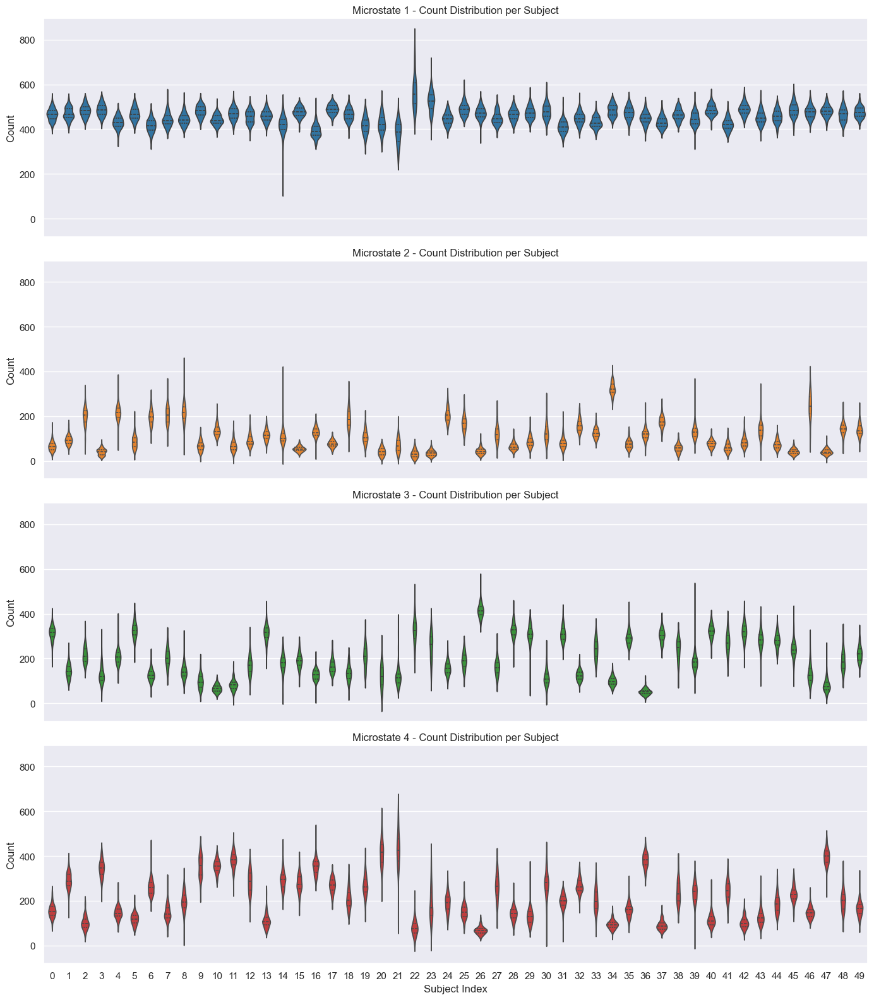

In [15]:
n_subjects = len(all_data)  # e.g. 50

# Prepare a long-format DataFrame for seaborn violinplot
records = []

for subj_idx, subj_data in enumerate(all_data):
    for trial in subj_data:
        # Count microstate occurrences per trial
        unique, counts = np.unique(trial, return_counts=True)
        count_dict = {state: 0 for state in range(4)}
        for u, c in zip(unique, counts):
            count_dict[u] = c
        for state in range(4):
            records.append({
                'Subject': subj_idx,
                'Microstate': state,
                'Count': count_dict[state]
            })

df_long = pd.DataFrame(records)

# Plotting 4 violins, one per microstate
fig, axs = plt.subplots(4, 1, figsize=(14, 16), sharex=True, sharey=True)

for state in range(4):
    ax = axs[state]
    sns.violinplot(
        x='Subject', y='Count', data=df_long[df_long['Microstate'] == state],
        ax=ax, inner='quartile', color=colors[state]
    )
    ax.set_title(f"Microstate {state+1} - Count Distribution per Subject")
    ax.set_ylabel("Count")

axs[-1].set_xlabel("Subject Index")

plt.tight_layout()
plt.show()


### Mean duration of microstates per trials

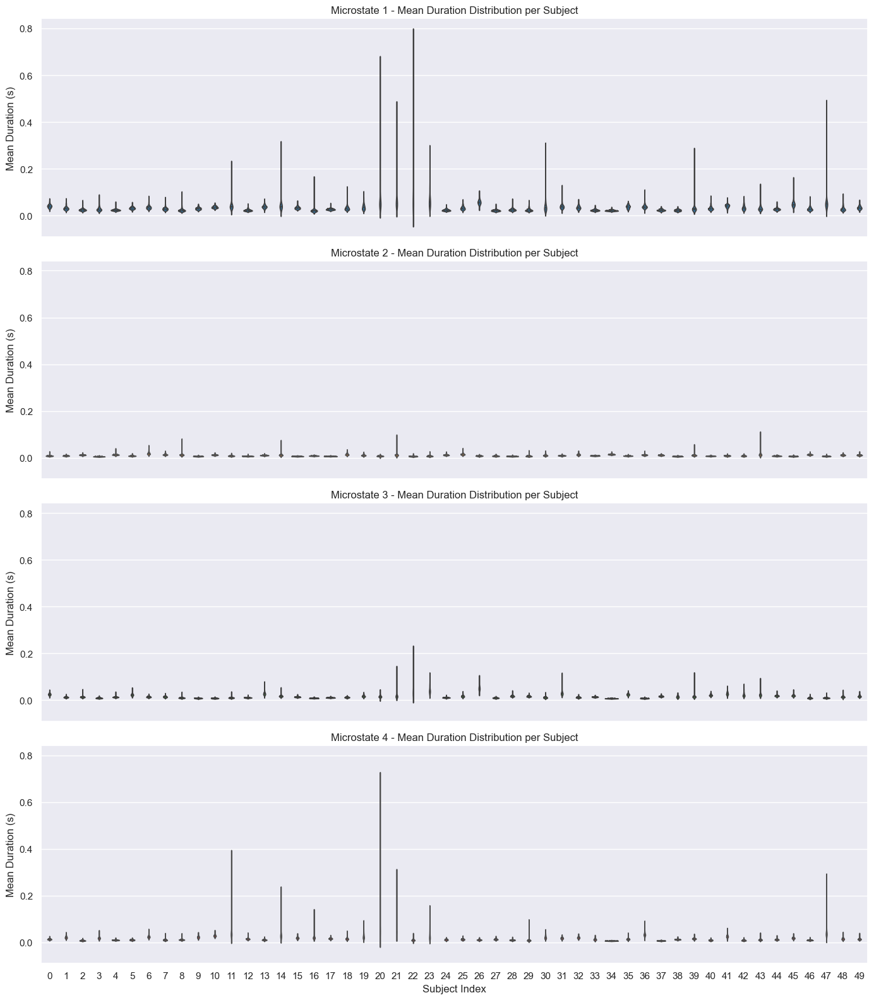

In [16]:
sampling_rate = 250
time_per_sample = 1 / sampling_rate

records = []

for subj_idx, subj_data in enumerate(all_data):
    for trial in subj_data:
        durations = {state: [] for state in range(4)}
        current_state = trial[0]
        start_idx = 0
        
        for i in range(1, len(trial)):
            if trial[i] != current_state:
                duration = (i - start_idx) * time_per_sample
                durations[current_state].append(duration)
                current_state = trial[i]
                start_idx = i
        
        # Last run
        duration = (len(trial) - start_idx) * time_per_sample
        durations[current_state].append(duration)
        
        # Calculate mean duration per microstate in this trial
        for state in range(4):
            mean_duration = np.mean(durations[state]) if durations[state] else 0
            records.append({
                'Subject': subj_idx,
                'Microstate': state,
                'MeanDuration': mean_duration
            })

df_long = pd.DataFrame(records)

# Plot violin plots
fig, axs = plt.subplots(4, 1, figsize=(14, 16), sharex=True, sharey=True)

for state in range(4):
    ax = axs[state]
    sns.violinplot(
        x='Subject', y='MeanDuration',
        data=df_long[df_long['Microstate'] == state],
        ax=ax, inner='quartile', color=colors[state]
    )
    ax.set_title(f"Microstate {state+1} - Mean Duration Distribution per Subject")
    ax.set_ylabel("Mean Duration (s)")

axs[-1].set_xlabel("Subject Index")

plt.tight_layout()
plt.show()


### Mean occurrences per seconds of microstates in the data per trials

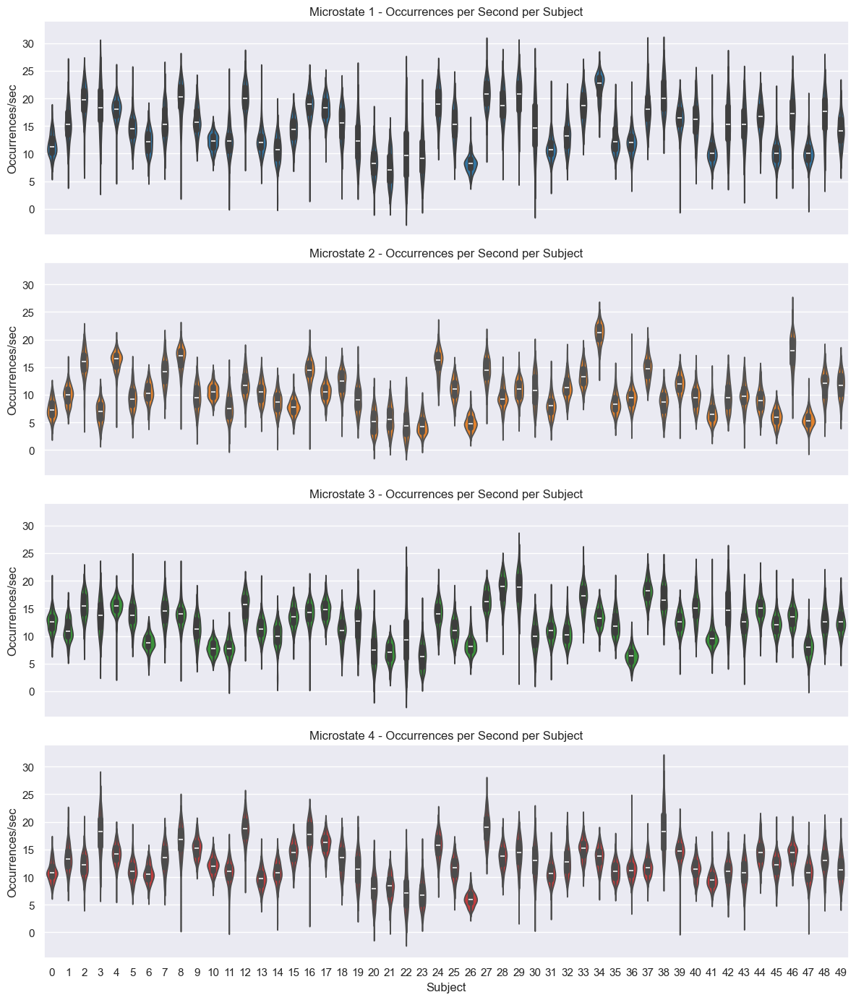

In [17]:
sampling_rate = 250  # 250 Hz → 1s = 250 samples
window_size = sampling_rate  # 1 second

all_subjects_mean_occurrences = []  # to collect data for all 50 subjects

for subject_idx, data in enumerate(all_data):  # all_data shape: (50, trials, timepoints)
    n_trials, n_timepoints = data.shape
    n_windows = n_timepoints // window_size

    # list for each trial's mean occurrence per state
    mean_occurrences_per_trial = []

    for trial in data:
        occ_counts = {state: [] for state in range(4)}
        for w in range(n_windows):
            start = w * window_size
            end = start + window_size
            segment = trial[start:end]
            prev = segment[0]
            occurrences = {state: 0 for state in range(4)}
            # Count transitions into each state in the window
            for i in range(1, len(segment)):
                if segment[i] != prev:
                    occurrences[segment[i]] += 1
                    prev = segment[i]
            for state in range(4):
                occ_counts[state].append(occurrences[state])

        mean_per_state = {f'ms{state}': np.mean(occ_counts[state]) for state in range(4)}
        mean_occurrences_per_trial.append(mean_per_state)

    # Create DataFrame for this subject's trials
    df_subject = pd.DataFrame(mean_occurrences_per_trial)
    df_subject['subject'] = subject_idx
    all_subjects_mean_occurrences.append(df_subject)

# Concatenate all subjects' data (trials pooled across subjects)
df_all = pd.concat(all_subjects_mean_occurrences, ignore_index=True)

# Now plot violin plots, one subplot per microstate
fig, axs = plt.subplots(4, 1, figsize=(12, 14), sharex=True, sharey=True)

for i in range(4):
    ax = axs[i]
    sns.violinplot(x='subject', y=f'ms{i}', data=df_all, ax=ax, color=colors[i])
    ax.set_title(f"Microstate {i+1} - Occurrences per Second per Subject")
    ax.set_ylabel("Occurrences/sec")
    if i == 3:
        ax.set_xlabel("Subject")


plt.tight_layout()
plt.show()


### Time coverage ratio of microstates per trials

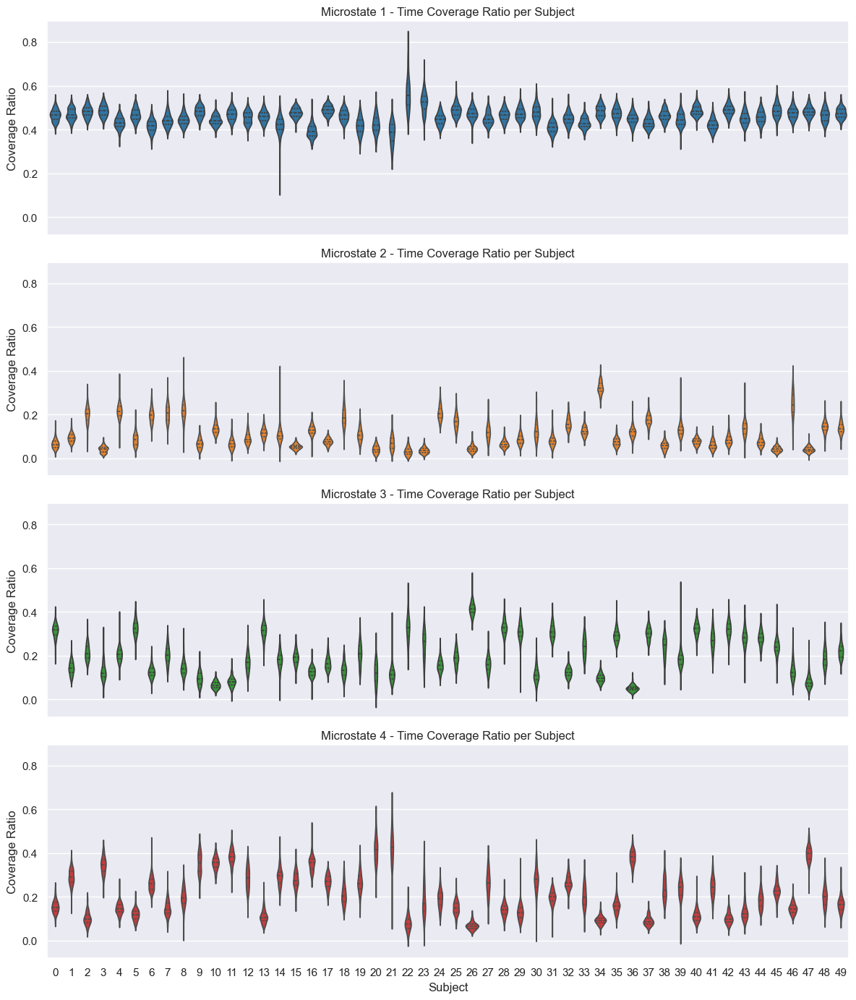

In [18]:
all_subjects_coverage = []

for subject_idx, data in enumerate(all_data):  # all_data shape: (50, trials, timepoints)
    n_trials, n_points = data.shape
    
    coverage = []
    for trial in data:
        coverage_dict = {}
        for state in range(4):
            coverage_dict[f'ms{state}'] = np.sum(trial == state) / n_points
        coverage.append(coverage_dict)
    
    df_subject_coverage = pd.DataFrame(coverage)
    df_subject_coverage['subject'] = subject_idx
    all_subjects_coverage.append(df_subject_coverage)

# Combine all subjects' coverage data
df_all_coverage = pd.concat(all_subjects_coverage, ignore_index=True)

# Define colors for the microstates (you can customize)

# Plot violin plots for each microstate coverage across subjects
fig, axs = plt.subplots(4, 1, figsize=(12, 14), sharex=True, sharey=True)

for i in range(4):
    ax = axs[i]
    sns.violinplot(x='subject', y=f'ms{i}', data=df_all_coverage, ax=ax, inner='quartile', color=colors[i])
    ax.set_title(f"Microstate {i+1} - Time Coverage Ratio per Subject")
    ax.set_ylabel("Coverage Ratio")
    if i == 3:
        ax.set_xlabel("Subject")

plt.tight_layout()
plt.show()


## Visualizing microstates using MNE

### Load all clusters


In [35]:
# load all data
n_subjects = 50
all_microstate_templates = []
for i in range(0, n_subjects):
    id_name = f'{i:03d}'  # Format id as three digits
    file_name = f't{id_name}.npy'
    data = mf.get_file_path(data_path, folder_path, file_name)
    all_microstate_templates.append(data)
file_name = f't_all.npy'
data = mf.get_file_path(data_path, folder_path, file_name)
all_microstate_templates.append(data)

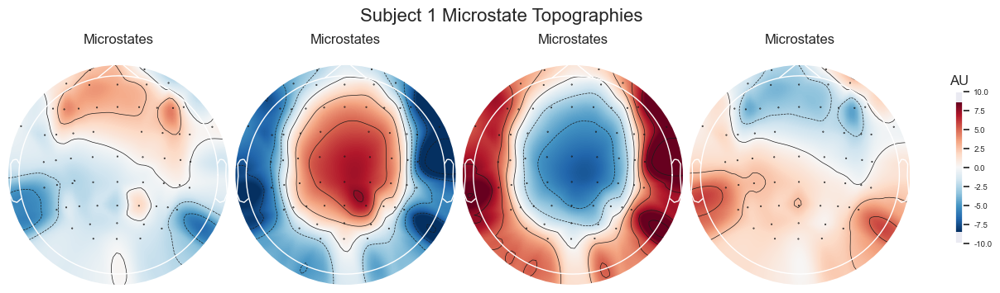

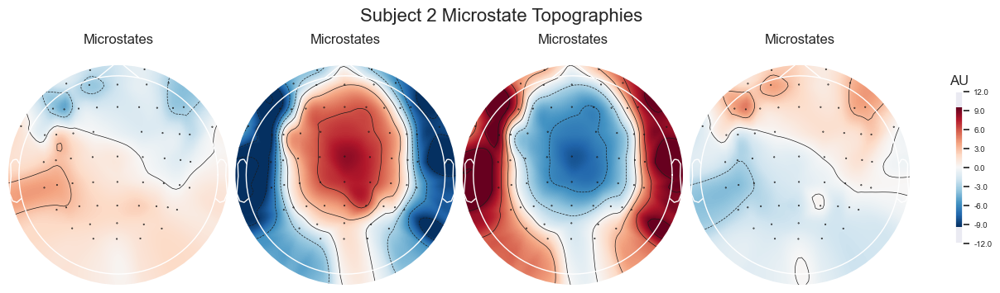

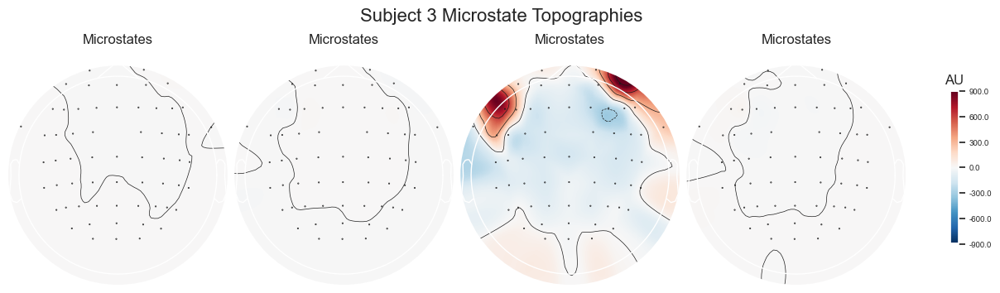

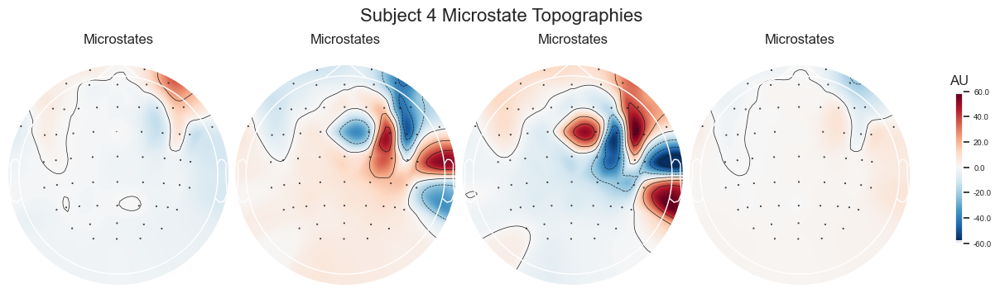

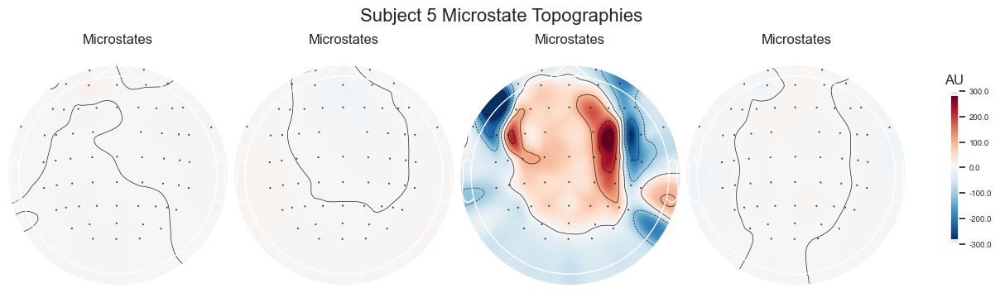

...

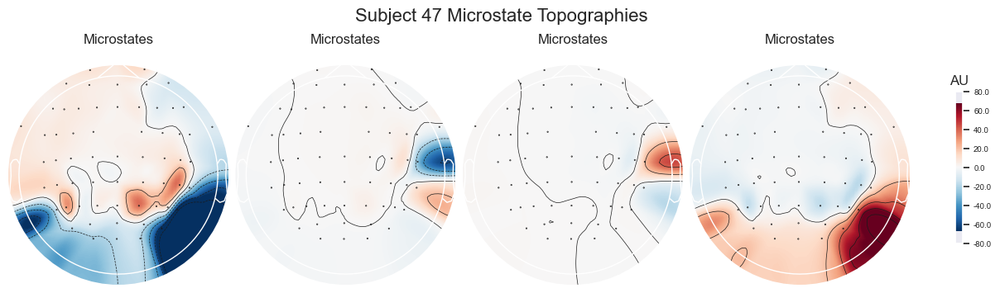

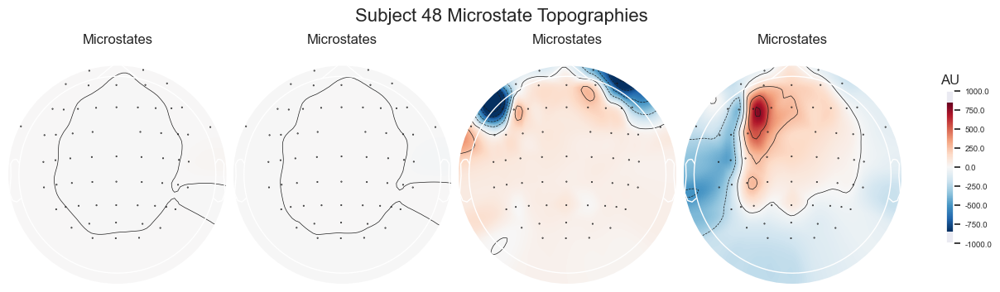

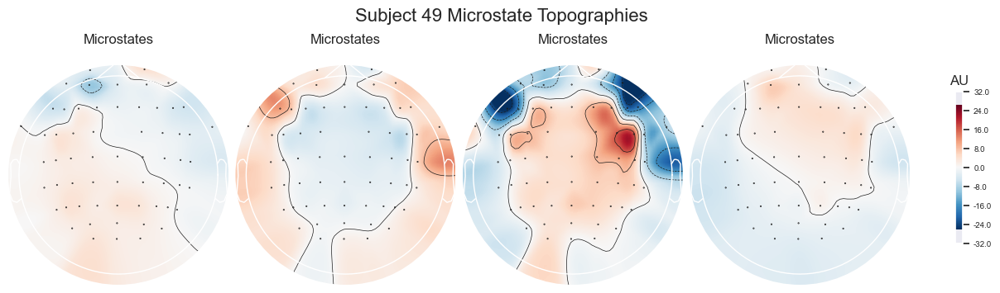

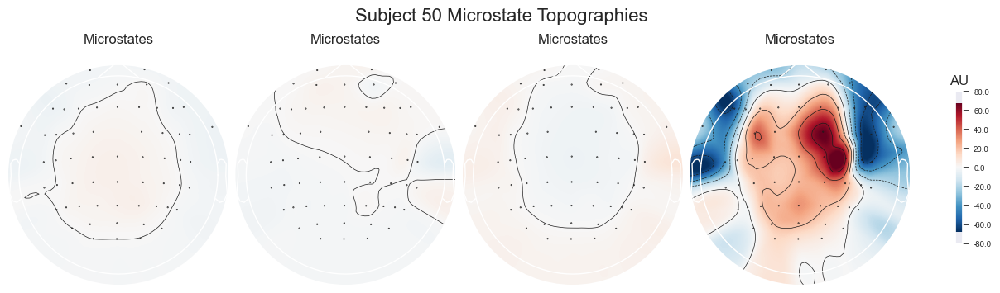

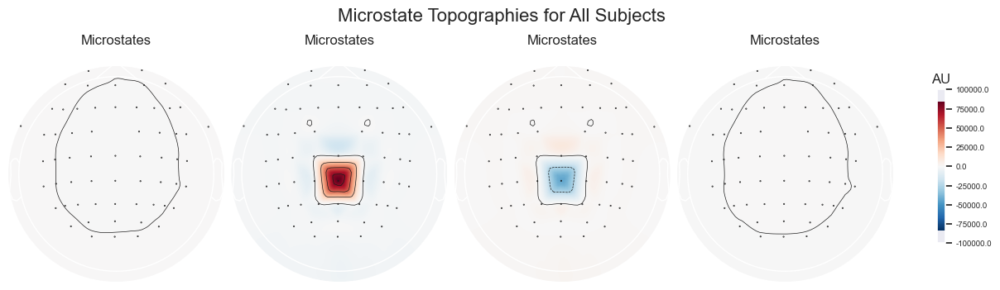

In [36]:
sfreq = 1000

# Create MNE Info with standard 10-20 montage
info = mne.create_info(ch_names=rest_ch_ls, sfreq=sfreq, ch_types='eeg')
montage = mne.channels.make_standard_montage('standard_1020')
info.set_montage(montage)

for subject_idx, microstate_templates in enumerate(all_microstate_templates):
    # microstate_templates expected shape: list or array with 4 arrays of shape (61,)
    # Stack along second axis -> (61, 4)
    data = np.stack(microstate_templates, axis=1)
    
    # Create EvokedArray for 4 microstates (as "time points")
    evoked = mne.EvokedArray(data, info, tmin=0)
    
    # Plot topomap side by side for the 4 microstates
    fig = evoked.plot_topomap(times='auto', time_format='Microstates',
                              scalings=1, cmap='RdBu_r', size=2, show=False)
    if subject_idx == n_subjects:
        fig.suptitle('Microstate Topographies for All Subjects', fontsize=16)
    else:
        fig.suptitle(f'Subject {subject_idx + 1} Microstate Topographies', fontsize=16)
    plt.show()


In [47]:
!pip show mne

Name: mne
Version: 1.9.0
Summary: MNE-Python project for MEG and EEG data analysis.
Home-page: https://mne.tools/
Author: 
Author-email: Alexandre Gramfort <alexandre.gramfort@inria.fr>
License: BSD-3-Clause
Location: c:\Users\josan\Documents\EPFL\These\.venv\Lib\site-packages
Requires: decorator, jinja2, lazy-loader, matplotlib, numpy, packaging, pooch, scipy, tqdm
Required-by: pycrostates


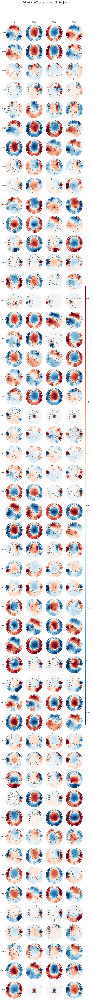

In [49]:
# Initialize this to store an image from one plot
cbar_im = None

# # Flatten all microstate data to find global min and max
# all_values = np.concatenate([np.stack(subj_templates) for subj_templates in all_microstate_templates])
# global_min = all_values.min()
# global_max = all_values.max()


fig, axs = plt.subplots(n_subjects, n_states, figsize=(n_states*1.5, n_subjects*1.5),
                        gridspec_kw={'wspace': 0.01, 'hspace': 0.05})

for subj_idx, microstate_templates in enumerate(all_microstate_templates):
    for state_idx in range(n_states):
        data = microstate_templates[state_idx]
        ax = axs[subj_idx, state_idx] if n_subjects > 1 else axs[state_idx]
        
        # Save the image object (only once is fine)
        im, _ = mne.viz.plot_topomap(data, info, axes=ax, show=False, cmap='RdBu_r', size=2)

        if cbar_im is None:
            cbar_im = im  # Save for the colorbar
        
        if subj_idx == 0:
            ax.set_title(f"MS {state_idx+1}", fontsize=9, pad=3)
        if state_idx == 0:
            if subj_idx == n_subjects - 1:
                ax.set_ylabel("All Subj", fontsize=7, rotation=0, labelpad=10, va='center')
            else:
                ax.set_ylabel(f"Subj {subj_idx+1}", fontsize=7, rotation=0, labelpad=10, va='center')

        ax.set_xticks([])
        ax.set_yticks([])

# Add one shared colorbar on the right
cbar_ax = fig.add_axes([0.96, 0.3, 0.015, 0.4])  # [left, bottom, width, height]
fig.colorbar(cbar_im, cax=cbar_ax)

plt.suptitle("Microstate Topographies: All Subjects", fontsize=14, y=0.96)
plt.subplots_adjust(left=0.01, right=0.95, top=0.94, bottom=0.05)

plt.show()


## Best K clusters
### Load best K clusters

In [10]:
id = 0

data_path = '../Output/'
folder_path = 'ica_rest_close/'
output_path = '../Output/' + folder_path
if not os.path.exists(output_path):
    os.makedirs(output_path)

id_name = f'{id:03d}'  # Format id as three digits
# id_name ='_all'
file_name = f'k{id_name}.npy'

In [11]:
# load all data
n_subjects = 50
all_scores = []
for i in range(0, n_subjects):
    id_name = f'{i:03d}'  # Format id as three digits
    file_name = f'k{id_name}.npy'
    data = mf.get_file_path(data_path, folder_path, file_name)
    all_scores.append(data)

In [12]:
all_scores = np.array(all_scores)  # shape: (12, trials, timepoints)

In [13]:
all_scores.shape[1]

39

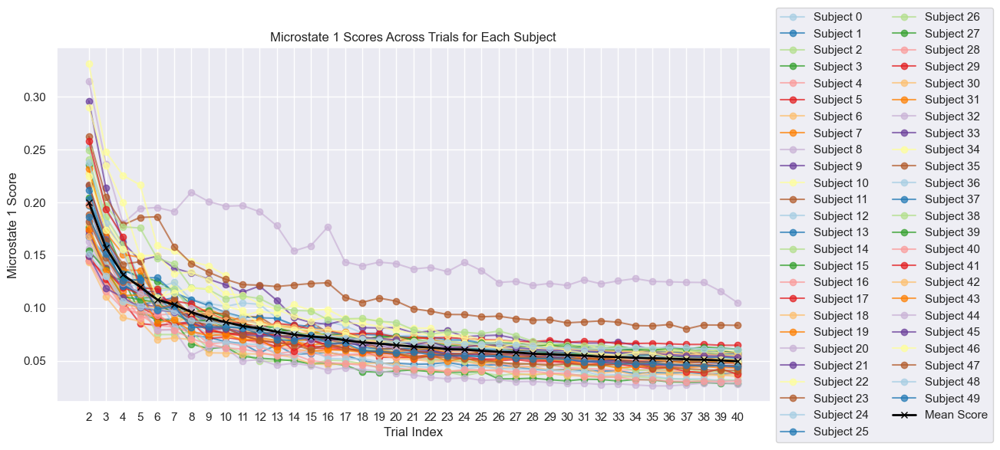

In [14]:
max_clusters = all_scores.shape[1] + 2  # e.g. 20 clusters
x = np.arange(2, max_clusters, 1)  # x-axis: trial indices
palette = sns.color_palette("Paired", n_subjects)  # Color palette for subjects
mean_scores = np.mean(all_scores, axis=0)  # shape: (trials, timepoints)
plt.figure(figsize=(12, 6))
for i in range(all_scores.shape[0]):
    plt.plot(x, all_scores[i, :], label=f'Subject {i}', marker='o', alpha=0.7, color=palette[i % len(palette)])

plt.plot(x, mean_scores, color='black', linewidth=2, label='Mean Score', marker='x')
plt.xlabel('Trial Index')
plt.ylabel('Microstate 1 Score')
plt.title('Microstate 1 Scores Across Trials for Each Subject')
plt.xticks(x)
plt.legend(bbox_to_anchor=(1, 0.5), loc='center left', ncols=2)

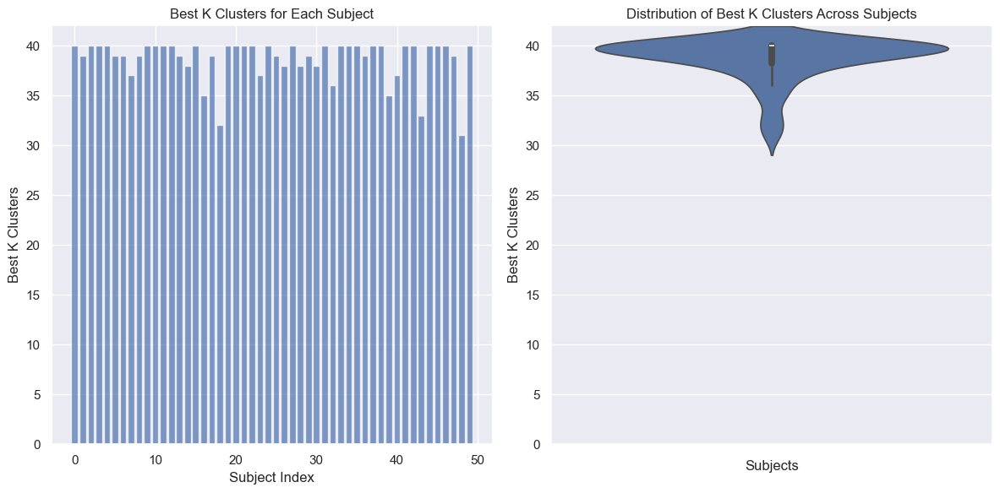

In [15]:
best_k_list = mf.get_file_path(data_path, folder_path, 'best_k_clusters.npy')
# plot best k clusters for each subjects
fig, axs = plt.subplots(1, 2, figsize=(12, 6))
x = np.arange(len(best_k_list))  # x-axis: subject indices
axs[0].bar(x, best_k_list, alpha=0.7)
axs[0].set_xlabel('Subject Index')
axs[0].set_ylabel('Best K Clusters')
axs[0].set_title('Best K Clusters for Each Subject')
axs[0].set_ylim(0, max_clusters+1)  # Set y-axis limit for better visibility
sns.violinplot(y=best_k_list, ax=axs[1])
axs[1].set_title('Distribution of Best K Clusters Across Subjects')
axs[1].set_ylabel('Best K Clusters')
axs[1].set_xlabel('Subjects')
axs[1].set_ylim(0, max_clusters+1)  # Set y-axis limit for better visibility
plt.tight_layout()
# plt.show()

## Looking at the EEG data

In [6]:
id = 20

data_path_EEG = '../Data/'
folder_path = 'ica_rest_open/'
output_path = '../Output/' + folder_path
if not os.path.exists(output_path):
    os.makedirs(output_path)

id_name = f'{id:03d}'  # Format id as three digits
# id_name ='_all'
file_name = f's{id_name}.npy'

In [7]:
# load all data
n_subjects = 50
all_data = []
for i in range(0, n_subjects):
    id_name = f'{i:03d}'  # Format id as three digits
    file_name = f's{id_name}.npy'
    data = mf.get_file_path(data_path_EEG, folder_path, file_name)
    all_data.append(data)

In [8]:

# Data shape: (n_trials, 1, 61, 1000)
for id, data in enumerate(all_data):
    print(f'Plotting EEG data for subject {id}...')
    data = data[:, 0, :, :]  # shape: (n_trials, 61, 1000)

    n_trials, n_channels, timepoints = data.shape
    sampling_rate = 250  # Hz

    # Concatenate trials along time axis
    data_concat = data.transpose(1, 0, 2).reshape(n_channels, -1)
    time_sec = np.arange(data_concat.shape[1]) / sampling_rate

    # Create figure and axes
    fig, axes = plt.subplots(n_channels, 1, figsize=(15, n_channels * 0.5), sharex=True, sharey=True)

    for ch in range(n_channels):
        ax = axes[ch]
        sns.lineplot(x=time_sec, y=data_concat[ch], ax=ax, linewidth=0.5)
        ax.set_ylabel(f'CH{ch+1}', rotation=0, labelpad=15, fontsize=8)
        # ax.set_ylim(-250,250)

    # Set x-axis ticks only on the last subplot
    xticks = np.linspace(0, time_sec[-1], 10)
    axes[-1].set_xticks(xticks)
    axes[-1].set_xticklabels([f'{t:.1f}' for t in xticks])
    axes[-1].set_xlabel('Time (s)', fontsize=10)

    # Set title with adjusted vertical position
    plt.suptitle(f'EEG Data for Subject {id}', fontsize=16, y=0.995)

    # Tidy layout with space for ylabel and title
    plt.subplots_adjust(left=0.08, right=0.98, top=0.97, bottom=0.05, hspace=0.15)
    id_name = f'{id:03d}'  # Format id as three digits
    output_raw_path = os.path.join(output_path, 'raw_eeg/')
    if not os.path.exists(output_raw_path):
        os.makedirs(output_raw_path)
    plt.savefig(os.path.join(output_raw_path, f's{id_name}.png'), dpi=300)
    plt.close(fig)  # Close the figure to free memory


Plotting EEG data for subject 0...
Plotting EEG data for subject 1...
Plotting EEG data for subject 2...
Plotting EEG data for subject 3...
Plotting EEG data for subject 4...
Plotting EEG data for subject 5...
Plotting EEG data for subject 6...
Plotting EEG data for subject 7...
Plotting EEG data for subject 8...
Plotting EEG data for subject 9...
Plotting EEG data for subject 10...
Plotting EEG data for subject 11...
Plotting EEG data for subject 12...
Plotting EEG data for subject 13...
Plotting EEG data for subject 14...
Plotting EEG data for subject 15...
Plotting EEG data for subject 16...
Plotting EEG data for subject 17...
Plotting EEG data for subject 18...
Plotting EEG data for subject 19...
Plotting EEG data for subject 20...
Plotting EEG data for subject 21...
Plotting EEG data for subject 22...
Plotting EEG data for subject 23...
Plotting EEG data for subject 24...
Plotting EEG data for subject 25...
Plotting EEG data for subject 26...
Plotting EEG data for subject 27...
Pl